# Homework 8 Report

**Image Processing**\
In this part, read bmp images from file and shape it into desired shape.

In [1]:
from PIL import Image
import os
import numpy as np
from PIL import Image
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow
# cupy is a GPU based library, please run this file under GPU enviornment.
import cupy as cp

# load images and resize it to target size.
def load_images_from_folder(folder_path):
    images = []
    for filename in os.listdir(folder_path):
        if filename.endswith(".bmp"):
            image_path = os.path.join(folder_path, filename)
            image = Image.open(image_path)
            images.append(np.array(image))
    return np.array(images)

def resize_images(images, target_size):
    transform = transforms.Compose([transforms.Resize(target_size)])
    resized_images = [transform(Image.fromarray(img)) for img in images]
    return np.array([np.array(img) for img in resized_images])

In [2]:
input_folder = '/content/drive/MyDrive/VideoSurvallience'

In [3]:

# Load BMP images from the folder
bmp_images = load_images_from_folder(input_folder)

# Define the target size for resizing each image (adjust based on your requirements)
individual_image_size = (160, 120)

# Resize each R, G, B image individually
r_resized = resize_images(bmp_images[:, :, :, 0], individual_image_size)
g_resized = resize_images(bmp_images[:, :, :, 1], individual_image_size)
b_resized = resize_images(bmp_images[:, :, :, 2], individual_image_size)
# Concatenate the reshaped R, G, B images along the height for each image
r_resized = np.transpose(r_resized.reshape((3055,-1)))
g_resized = np.transpose(g_resized.reshape((3055,-1)))
b_resized = np.transpose(b_resized.reshape((3055,-1)))
# check the size.
print(r_resized.shape)
print(g_resized.shape)
print(b_resized.shape)

(19200, 3055)
(19200, 3055)
(19200, 3055)


In [4]:
# create M1, M2, M3 to run it in ADMM.
M1 = np.copy(r_resized)
M2 = np.copy(g_resized)
M3 = np.copy(b_resized)
num_blocks = 5

# Create an empty list to store the blocks
M1_blocks = []
M2_blocks = []
M3_blocks = []
# Calculate the number of columns in each block
columns_per_block = M1.shape[1] // num_blocks

# Split the tensor into blocks along the columns
for i in range(num_blocks):
    start_col = i * columns_per_block
    end_col = (i + 1) * columns_per_block
    M1_block = M1[:, start_col:end_col]
    M2_block = M2[:, start_col:end_col]
    M3_block = M3[:, start_col:end_col]
    M1_blocks.append(M1_block)
    M2_blocks.append(M2_block)
    M3_blocks.append(M3_block)
# check new shape.
print(M1_blocks[0].shape)
print(M2_blocks[0].shape)
print(M3_blocks[0].shape)


(19200, 611)
(19200, 611)
(19200, 611)


**Important functions for ADMM algorithms**\
In this part, implement singular value thresholding, soft thresholding and ADMM update.

In [8]:
def singular_value_thresholding(M,St,Gamma,tau):
    """
    Perform Singular Value Thresholding on a matrix.

    Parameters:
    - matrix: The input matrix.
    - tau: Threshold value: equals to 1/\rho

    Returns:
    - The thresholded matrix.
    """
    matrix = M-St-tau*Gamma
    # Perform Singular Value Decomposition (SVD)
    #U, S, Vt = np.linalg.svd(matrix, full_matrices=False)
    U, S, Vt = cp.linalg.svd(cp.array(matrix), full_matrices=False)
    U = cp.asnumpy(U)
    S = cp.asnumpy(S)
    Vt = cp.asnumpy(Vt)
    # Apply soft thresholding to singular values
    S_thresholded = np.maximum(S - tau, 0)

    # Reconstruct the thresholded matrix
    thresholded_matrix = U @ np.diag(S_thresholded) @ Vt

    return thresholded_matrix

def soft_thresholding(M,L,Gamma,lambda0 ,tau):
    """
    Perform soft thresholding on a matrix.

    Parameters:
    - matrix: The input matrix.
    - tau: Threshold value: equals to 1/\rho

    Returns:
    - The matrix after soft thresholding.
    """
    matrix = M - L - tau*Gamma
    threshold = tau*lambda0
    thresholded_matrix = np.sign(matrix) * np.maximum(np.abs(matrix) - threshold, 0)
    return thresholded_matrix

def rPCA(M,S_t,Gamma_t,lambda0, tau):
  # Implement ADMM algorithm for rPCA problem.
  # Recall from ADMM lecture slide 17.

  Lnew = singular_value_thresholding(M,S_t,Gamma_t,tau)

  Snew = soft_thresholding(M,Lnew,Gamma_t,lambda0,tau)

  Gamma_new = Gamma_t+ 1/tau*(Lnew + Snew - M)

  return Lnew, Snew, Gamma_new

**Test Case for ADMM**\
Run reshaped R,G,B blocks seperately.Each block is separated by 5 blocks.

In [27]:
T = 180
# Hyper-parameter setting.
lambda0 = 1/np.sqrt(19200)
rho = 0.01
tau = 1/rho
# ADMM for R channel.
L1_processed = []
S1_processed = []
for i,Mr in enumerate(M1_blocks):
  L0 = Mr
  m,n = Mr.shape
  S0 = np.zeros((m,n))
  Gamma0 = np.zeros((m,n))
  count = 0
  while count < T:
    L0,S0,Gamma0 = rPCA(Mr,S0,Gamma0,lambda0,tau)

    count += 1
  L1_processed.append(L0)
  S1_processed.append(S0)

In [28]:
# ADMM for G channel
L2_processed = []
S2_processed = []
for i,Mr in enumerate(M2_blocks):
  L0 = Mr
  m,n = Mr.shape
  S0 = np.zeros((m,n))
  Gamma0 = np.zeros((m,n))
  count = 0
  while count < T:
    L0,S0,Gamma0 = rPCA(Mr,S0,Gamma0,lambda0,tau)
    count += 1
  L2_processed.append(L0)
  S2_processed.append(S0)

In [29]:
# ADMM for B Channel
L3_processed = []
S3_processed = []
for i,Mr in enumerate(M3_blocks):
  L0 = Mr
  m,n = Mr.shape
  S0 = np.zeros((m,n))
  Gamma0 = np.zeros((m,n))
  count = 0
  while count < T:
    L0,S0,Gamma0 = rPCA(Mr,S0,Gamma0,lambda0,tau)
    count += 1
  L3_processed.append(L0)
  S3_processed.append(S0)

In [30]:

# Concatenate and reshape images as original size.
L1 = np.concatenate(L1_processed, axis=1)
L2 = np.concatenate(L2_processed, axis=1)
L3 = np.concatenate(L3_processed, axis=1)

S1 = np.concatenate(S1_processed, axis=1)
S2 = np.concatenate(S2_processed, axis=1)
S3 = np.concatenate(S3_processed, axis=1)

num_images = 3305
image_size = (160, 120)
L1_reshaped = L1.reshape((image_size[0], image_size[1], -1))
L2_reshaped = L2.reshape((image_size[0], image_size[1], -1))
L3_reshaped = L3.reshape((image_size[0], image_size[1], -1))

S1_reshaped = S1.reshape((image_size[0], image_size[1], -1))
S2_reshaped = S2.reshape((image_size[0], image_size[1], -1))
S3_reshaped = S3.reshape((image_size[0], image_size[1], -1))


#rgb_image = np.stack([r_channel, g_channel, b_channel], axis=-1)
#rgb_images = np.stack(np.split(reshaped_matrix, num_images, axis=2), axis=3)

In [31]:
print(L1_reshaped.shape)

(160, 120, 3055)


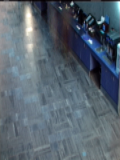

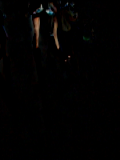

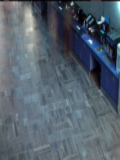

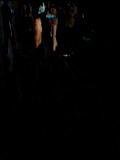

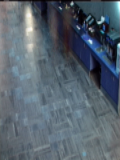

...

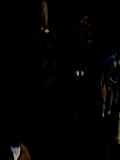

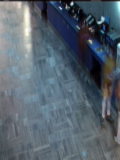

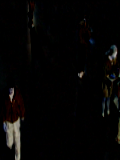

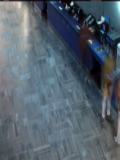

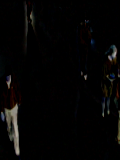

In [34]:
# visualize, to save time, visualize first 330 frames of video images.
num_images = 330
image_size = (160, 120)
# Reshape the matrix into a shape suitable for representing images
#reshaped_matrix = rgb_L.reshape((image_size[0], image_size[1], -1))
#rgb_images = np.stack(np.split(reshaped_matrix, num_images, axis=2), axis=3)
# Separate the images for display
for i in range(num_images):
    Lr = L1_reshaped[:, :, i :(i + 1) ]
    Lg = L2_reshaped[:,:,i:(i+1)]
    Lb = L3_reshaped[:, :, i:(i+1)]
    L_rgb = np.stack([Lr, Lg, Lb], axis=-1)
    L_rgb = np.squeeze(L_rgb)
    L_rgb = np.clip(L_rgb, 0, 255).astype(np.uint8)
    Sr = S1_reshaped[:, :, i :(i + 1) ]
    Sg = S2_reshaped[:,:,i:(i+1)]
    Sb = S3_reshaped[:, :, i:(i+1)]
    S_rgb = np.stack([Sr, Sg, Sb], axis=-1)
    S_rgb = np.squeeze(S_rgb)
    S_rgb = np.clip(S_rgb, 0, 255).astype(np.uint8)
    # Display the sample RGB image using OpenCV
    cv2_imshow(L_rgb)
    cv2_imshow(S_rgb)
    cv2.waitKey(0)
    cv2.destroyAllWindows()